<a href="https://colab.research.google.com/github/ArunAravind2001/Music-Generation-using-GAN/blob/main/Music_Generation_using_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
from PIL import Image
import torch
import torch.optim as optim
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import torch.nn.utils.spectral_norm as spectral_norm

# Dataset class for mel spectrogram images
class MelSpectrogramDataset(Dataset):
    def __init__(self, image_folder, transform=None):
        self.image_folder = image_folder
        self.transform = transform
        self.image_files = [f for f in os.listdir(image_folder) if f.endswith('.png')]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_path = os.path.join(self.image_folder, self.image_files[idx])
        image = Image.open(image_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image

# Generator model
class Generator(nn.Module):
    def __init__(self, z_dim):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(z_dim, 512, 4, 1, 0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),

            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, x):
        return self.main(x)

# Enhanced Discriminator with spectral normalization
class EnhancedDiscriminator(nn.Module):
    def __init__(self):
        super(EnhancedDiscriminator, self).__init__()
        self.main = nn.Sequential(
            spectral_norm(nn.Conv2d(3, 64, 4, 2, 1)),
            nn.LeakyReLU(0.2, inplace=True),

            spectral_norm(nn.Conv2d(64, 128, 4, 2, 1)),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            spectral_norm(nn.Conv2d(128, 256, 4, 2, 1)),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            spectral_norm(nn.Conv2d(256, 512, 4, 2, 1)),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(512, 1, 4, 1, 0)
        )
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = self.main(x)
        return self.sigmoid(x.view(x.size(0), -1)).squeeze()

# Device setup
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Hyperparameters
batch_size = 32
z_dim = 100
epochs = 50
learning_rate = 0.0002

# Initialize models
generator = Generator(z_dim).to(device)
discriminator = EnhancedDiscriminator().to(device)

# Loss function and optimizers
criterion = nn.BCELoss()
optimizer_g = optim.Adam(generator.parameters(), lr=learning_rate, betas=(0.5, 0.999))
optimizer_d = optim.Adam(discriminator.parameters(), lr=learning_rate, betas=(0.5, 0.999))

# Data loading
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

def train_gan(dataloader, epochs):
    for epoch in range(epochs):
        for i, real_images in enumerate(dataloader):
            current_batch_size = real_images.size(0)
            real_images = real_images.to(device)

            # Create labels
            real_labels = torch.ones(current_batch_size, device=device)
            fake_labels = torch.zeros(current_batch_size, device=device)

            # Train Discriminator
            discriminator.zero_grad()

            # Real images
            d_output_real = discriminator(real_images)
            d_loss_real = criterion(d_output_real, real_labels)

            # Fake images
            z = torch.randn(current_batch_size, z_dim, 1, 1, device=device)
            fake_images = generator(z)
            d_output_fake = discriminator(fake_images.detach())
            d_loss_fake = criterion(d_output_fake, fake_labels)

            d_loss = d_loss_real + d_loss_fake
            d_loss.backward()
            optimizer_d.step()

            # Train Generator
            generator.zero_grad()
            g_output = discriminator(fake_images)
            g_loss = criterion(g_output, real_labels)
            g_loss.backward()
            optimizer_g.step()

            if i % 100 == 0:
                print(f"Epoch [{epoch+1}/{epochs}], Step [{i+1}/{len(dataloader)}], "
                      f"D Loss: {d_loss.item():.4f}, G Loss: {g_loss.item():.4f}")

        # Save models periodically
        if (epoch + 1) % 10 == 0:
            torch.save(generator.state_dict(), f"generator_epoch_{epoch+1}.pth")
            torch.save(discriminator.state_dict(), f"discriminator_epoch_{epoch+1}.pth")

# Usage
image_folder = '/content/drive/MyDrive/mel_spectrograms'  # Replace with your path
dataset = MelSpectrogramDataset(image_folder=image_folder, transform=transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Start training
train_gan(dataloader, epochs)


Epoch [1/50], Step [1/39], D Loss: 1.3473, G Loss: 2.5885
Epoch [2/50], Step [1/39], D Loss: 0.0097, G Loss: 7.9842
Epoch [3/50], Step [1/39], D Loss: 0.0057, G Loss: 7.9353
Epoch [4/50], Step [1/39], D Loss: 0.4303, G Loss: 7.4260
Epoch [5/50], Step [1/39], D Loss: 0.0805, G Loss: 19.3676
Epoch [6/50], Step [1/39], D Loss: 0.0387, G Loss: 8.2204
Epoch [7/50], Step [1/39], D Loss: 0.0196, G Loss: 6.2994
Epoch [8/50], Step [1/39], D Loss: 0.0187, G Loss: 5.9915
Epoch [9/50], Step [1/39], D Loss: 0.0137, G Loss: 6.1948
Epoch [10/50], Step [1/39], D Loss: 0.1299, G Loss: 3.6190
Epoch [11/50], Step [1/39], D Loss: 0.0790, G Loss: 3.7410
Epoch [12/50], Step [1/39], D Loss: 0.0667, G Loss: 4.5549
Epoch [13/50], Step [1/39], D Loss: 0.2572, G Loss: 4.7200
Epoch [14/50], Step [1/39], D Loss: 0.7241, G Loss: 4.0694
Epoch [15/50], Step [1/39], D Loss: 2.7869, G Loss: 3.1876
Epoch [16/50], Step [1/39], D Loss: 1.0622, G Loss: 1.4718
Epoch [17/50], Step [1/39], D Loss: 0.5071, G Loss: 1.7662
Epoch

In [ ]:
!pip install pydub

<ipython-input-9-505294833e46>:16: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(checkpoint_path))
<ipython-input-9-505294833e46>:25: Fu

Generating mel spectrograms...
Applying super-resolution...
Converting to audio...


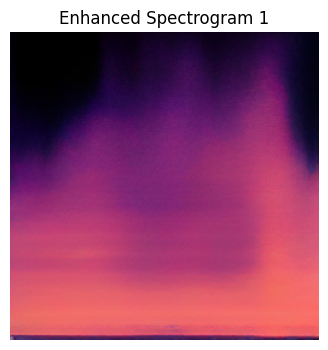

Successfully processed spectrogram 1


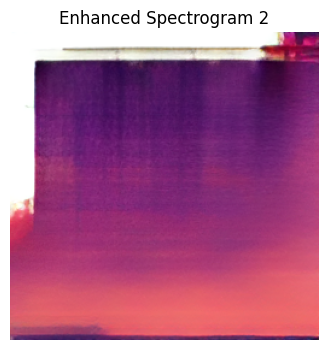

Successfully processed spectrogram 2


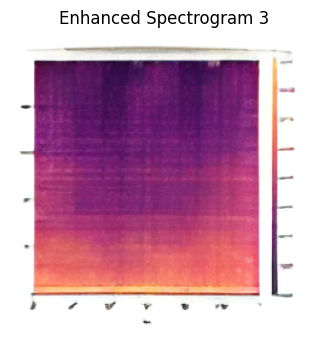

Successfully processed spectrogram 3


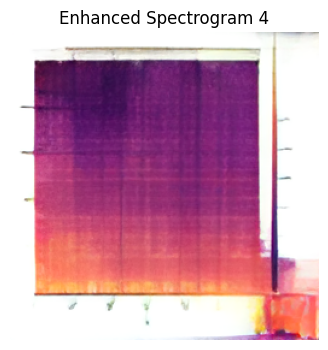

Successfully processed spectrogram 4


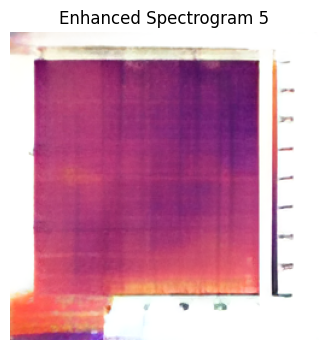

Successfully processed spectrogram 5


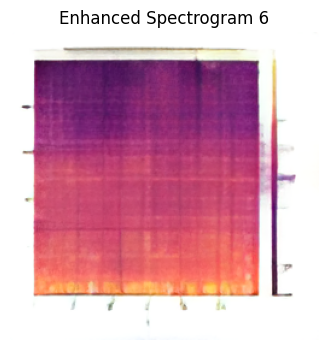

Successfully processed spectrogram 6


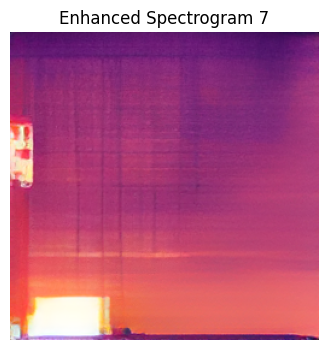

Successfully processed spectrogram 7


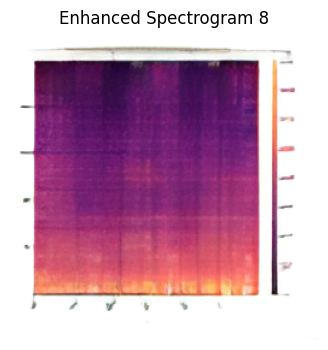

Successfully processed spectrogram 8


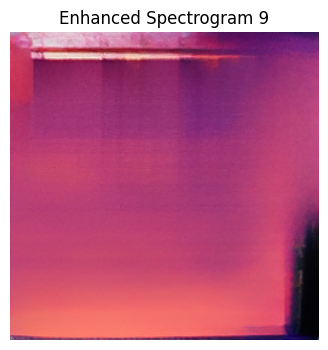

Successfully processed spectrogram 9


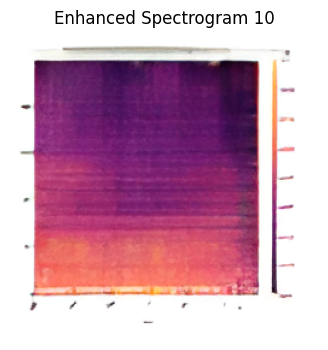

Successfully processed spectrogram 10


In [ ]:
import torch
import torch.nn as nn
import numpy as np
from basicsr.archs.rrdbnet_arch import RRDBNet
from basicsr.utils.download_util import load_file_from_url
from PIL import Image
import librosa
import soundfile as sf
from torchvision import transforms
import matplotlib.pyplot as plt
from pydub import AudioSegment  # For converting WAV to MP3

# Load your trained generator
def load_generator(checkpoint_path, z_dim=100):
    generator = Generator(z_dim).to(device)
    generator.load_state_dict(torch.load(checkpoint_path))
    generator.eval()
    return generator

# Load pretrained ESRGAN model
def load_sr_model():
    model = RRDBNet(num_in_ch=3, num_out_ch=3, num_feat=64, num_block=23, num_grow_ch=32)
    model_url = 'https://github.com/xinntao/Real-ESRGAN/releases/download/v0.1.0/RealESRGAN_x4plus.pth'
    model_path = load_file_from_url(model_url, model_dir='weights')
    loadnet = torch.load(model_path)
    if 'params_ema' in loadnet:
        keyname = 'params_ema'
    else:
        keyname = 'params'
    model.load_state_dict(loadnet[keyname], strict=True)
    model.eval()
    model = model.to(device)
    return model

# Generate mel spectrograms
def generate_spectrograms(generator, num_images=10):
    generated_images = []
    with torch.no_grad():
        for _ in range(num_images):
            z = torch.randn(1, z_dim, 1, 1, device=device)
            fake_image = generator(z)
            # Denormalize the image
            fake_image = (fake_image + 1) / 2
            generated_images.append(fake_image.squeeze(0))
    return generated_images

# Apply super-resolution to images
def enhance_images(sr_model, images):
    enhanced_images = []
    for img in images:
        with torch.no_grad():
            # Ensure input is in correct format (1, 3, H, W)
            img = img.unsqueeze(0)
            enhanced = sr_model(img)
            enhanced = torch.clamp(enhanced, 0, 1)
            enhanced_images.append(enhanced.squeeze(0))
    return enhanced_images

# Convert spectrogram to audio
def spectrogram_to_audio(spectrogram, sr=22050, n_fft=2048, hop_length=512):
    # Convert to numpy and scale appropriately
    spec = spectrogram.cpu().numpy()

    # Convert RGB to grayscale by taking average
    if len(spec.shape) == 3:
        spec = spec.mean(axis=0)

    # Resize spectrogram to appropriate dimensions
    target_height = n_fft // 2 + 1
    from scipy.ndimage import zoom
    zoom_factor = target_height / spec.shape[0]
    spec = zoom(spec, zoom_factor, order=1)

    # Scale to appropriate range and ensure non-negative
    spec = np.abs(spec)  # Ensure non-negative
    spec = librosa.db_to_power(spec * 100 - 100)  # Adjust scaling factors as needed

    # Perform Griffin-Lim algorithm
    audio = librosa.griffinlim(
        spec,
        n_iter=32,
        hop_length=hop_length,
        win_length=n_fft
    )

    return audio

# Display and save spectrogram
def save_and_display_spectrogram(spec, index):
    plt.figure(figsize=(10, 4))
    plt.imshow(spec.permute(1, 2, 0).cpu().numpy())
    plt.axis('off')
    plt.title(f"Enhanced Spectrogram {index+1}")
    plt.savefig(f'enhanced_spectrogram_{index+1}.png')
    plt.show()

# Convert WAV to MP3
def convert_wav_to_mp3(wav_file, mp3_file):
    audio = AudioSegment.from_wav(wav_file)
    audio.export(mp3_file, format="mp3")

def main():
    # Load models
    generator = load_generator('generator_epoch_40.pth')
    sr_model = load_sr_model()

    # Generate images
    print("Generating mel spectrograms...")
    generated_specs = generate_spectrograms(generator, num_images=10)

    # Enhance images
    print("Applying super-resolution...")
    enhanced_specs = enhance_images(sr_model, generated_specs)

    # Convert to audio and save
    print("Converting to audio...")
    for i, spec in enumerate(enhanced_specs):
        # Convert to audio
        try:
            audio = spectrogram_to_audio(spec)
            wav_file = f'generated_audio_{i+1}.wav'
            sf.write(wav_file, audio, 22050)

            # Convert WAV to MP3
            mp3_file = f'generated_audio_{i+1}.mp3'
            convert_wav_to_mp3(wav_file, mp3_file)

            # Display and save spectrogram image
            save_and_display_spectrogram(spec, i)
            print(f"Successfully processed spectrogram {i+1}")
        except Exception as e:
            print(f"Error processing spectrogram {i+1}: {str(e)}")

if __name__ == "__main__":
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    z_dim = 100
    main()

<ipython-input-12-d6fb34cce9c2>:34: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(checkpoint_path))
<ipython-input-12-d6fb34cce9c2>:53: 

Generating mel spectrograms...
Applying super-resolution...
Converting to audio...


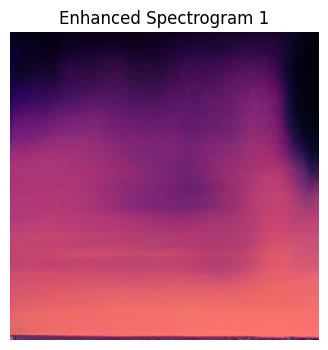

Playing generated audio 1


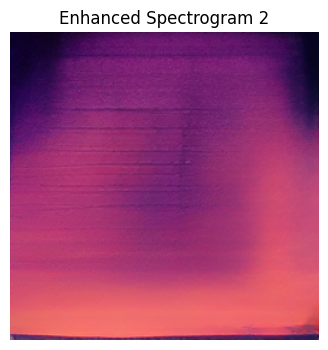

Playing generated audio 2


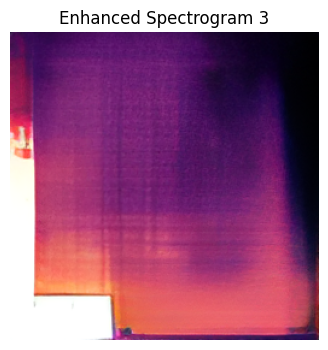

Playing generated audio 3


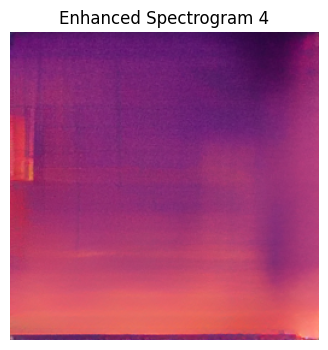

Playing generated audio 4


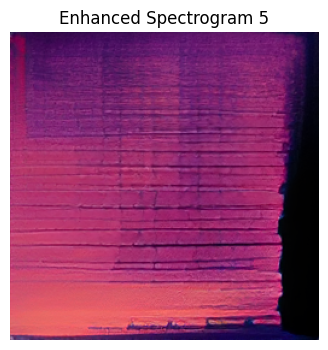

Playing generated audio 5


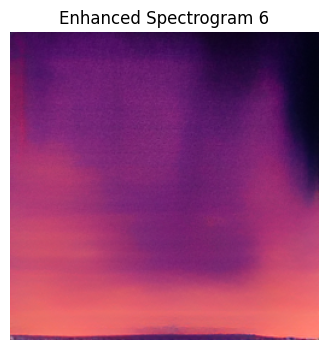

Playing generated audio 6


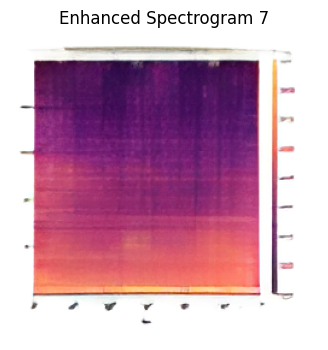

Playing generated audio 7


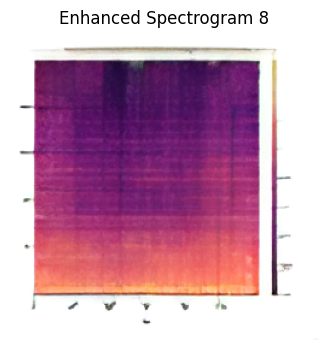

Playing generated audio 8


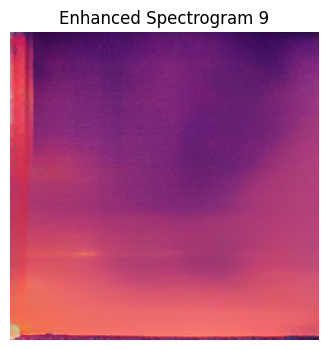

Playing generated audio 9


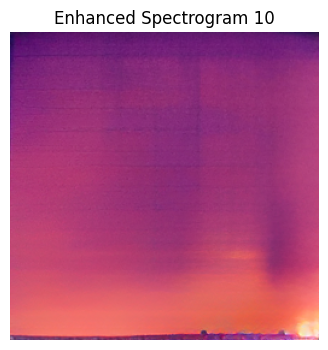

Playing generated audio 10


In [ ]:

import torch

import torch.nn as nn

import numpy as np

from basicsr.archs.rrdbnet_arch import RRDBNet

from basicsr.utils.download_util import load_file_from_url

from PIL import Image

import librosa

import soundfile as sf

from torchvision import transforms

import matplotlib.pyplot as plt

from pydub import AudioSegment

from IPython.display import Audio, display  # For playing audio




# Load your trained generator

def load_generator(checkpoint_path, z_dim=100):

    generator = Generator(z_dim).to(device)

    generator.load_state_dict(torch.load(checkpoint_path))

    generator.eval()

    return generator




# Load pretrained ESRGAN model

def load_sr_model():

    model = RRDBNet(num_in_ch=3, num_out_ch=3, num_feat=64, num_block=23, num_grow_ch=32)

    model_url = 'https://github.com/xinntao/Real-ESRGAN/releases/download/v0.1.0/RealESRGAN_x4plus.pth'

    model_path = load_file_from_url(model_url, model_dir='weights')

    loadnet = torch.load(model_path)

    if 'params_ema' in loadnet:

        keyname = 'params_ema'

    else:

        keyname = 'params'

    model.load_state_dict(loadnet[keyname], strict=True)

    model.eval()

    model = model.to(device)

    return model




# Generate mel spectrograms

def generate_spectrograms(generator, num_images=10):

    generated_images = []

    with torch.no_grad():

        for _ in range(num_images):

            z = torch.randn(1, z_dim, 1, 1, device=device)

            fake_image = generator(z)

            fake_image = (fake_image + 1) / 2

            generated_images.append(fake_image.squeeze(0))

    return generated_images




# Apply super-resolution to images

def enhance_images(sr_model, images):

    enhanced_images = []

    for img in images:

        with torch.no_grad():

            img = img.unsqueeze(0)

            enhanced = sr_model(img)

            enhanced = torch.clamp(enhanced, 0, 1)

            enhanced_images.append(enhanced.squeeze(0))

    return enhanced_images




# Convert spectrogram to audio

def spectrogram_to_audio(spectrogram, sr=22050, n_fft=2048, hop_length=512):

    spec = spectrogram.cpu().numpy()

    if len(spec.shape) == 3:

        spec = spec.mean(axis=0)

    from scipy.ndimage import zoom

    zoom_factor = (n_fft // 2 + 1) / spec.shape[0]

    spec = zoom(spec, zoom_factor, order=1)

    spec = np.abs(spec)

    spec = librosa.db_to_power(spec * 100 - 100)

    audio = librosa.griffinlim(spec, n_iter=32, hop_length=hop_length, win_length=n_fft)

    return audio




# Display and save spectrogram

def save_and_display_spectrogram(spec, index):

    plt.figure(figsize=(10, 4))

    plt.imshow(spec.permute(1, 2, 0).cpu().numpy())

    plt.axis('off')

    plt.title(f"Enhanced Spectrogram {index+1}")

    plt.savefig(f'enhanced_spectrogram_{index+1}.png')

    plt.show()




# Convert WAV to MP3

def convert_wav_to_mp3(wav_file, mp3_file):

    audio = AudioSegment.from_wav(wav_file)

    audio.export(mp3_file, format="mp3")




# Play audio in Jupyter Notebook

def play_audio(file_path):

    display(Audio(file_path))




def main():

    generator = load_generator('generator_epoch_40.pth')

    sr_model = load_sr_model()

    print("Generating mel spectrograms...")

    generated_specs = generate_spectrograms(generator, num_images=10)

    print("Applying super-resolution...")

    enhanced_specs = enhance_images(sr_model, generated_specs)

    print("Converting to audio...")

    for i, spec in enumerate(enhanced_specs):

        try:

            audio = spectrogram_to_audio(spec)

            wav_file = f'generated_audio_{i+1}.wav'

            sf.write(wav_file, audio, 22050)

            mp3_file = f'generated_audio_{i+1}.mp3'

            convert_wav_to_mp3(wav_file, mp3_file)

            save_and_display_spectrogram(spec, i)

            print(f"Playing generated audio {i+1}")

            play_audio(mp3_file)  # Play the MP3 file

        except Exception as e:

            print(f"Error processing spectrogram {i+1}: {str(e)}")




if __name__ == "__main__":

    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

    z_dim = 100

    main()



In [ ]:

import torch

import torch.nn as nn

import numpy as np

from basicsr.archs.rrdbnet_arch import RRDBNet

from basicsr.utils.download_util import load_file_from_url

from PIL import Image

import librosa

import soundfile as sf

from torchvision import transforms

import matplotlib.pyplot as plt

from IPython.display import Audio, display  # For playing audio in notebook




def load_generator(checkpoint_path, z_dim=100):

    generator = Generator(z_dim).to(device)

    generator.load_state_dict(torch.load(checkpoint_path, weights_only=True))

    generator.eval()

    return generator




def load_sr_model():

    model = RRDBNet(num_in_ch=3, num_out_ch=3, num_feat=64, num_block=23, num_grow_ch=32)

    model_url = 'https://github.com/xinntao/Real-ESRGAN/releases/download/v0.1.0/RealESRGAN_x4plus.pth'

    model_path = load_file_from_url(model_url, model_dir='weights')

    loadnet = torch.load(model_path, weights_only=True)

    if 'params_ema' in loadnet:

        keyname = 'params_ema'

    else:

        keyname = 'params'

    model.load_state_dict(loadnet[keyname], strict=True)

    model.eval()

    model = model.to(device)

    return model




def generate_spectrograms(generator, num_images=10):

    generated_images = []

    with torch.no_grad():

        for _ in range(num_images):

            z = torch.randn(1, z_dim, 1, 1, device=device)

            fake_image = generator(z)

            fake_image = (fake_image + 1) / 2

            fake_image = fake_image.squeeze(0)

            fake_image = 0.299 * fake_image[0] + 0.587 * fake_image[1] + 0.114 * fake_image[2]

            fake_image = torch.log10(torch.clamp(fake_image, min=1e-7))

            fake_image = fake_image.unsqueeze(0).repeat(3, 1, 1)

            generated_images.append(fake_image)

    return generated_images




def enhance_images(sr_model, images):

    enhanced_images = []

    for img in images:

        with torch.no_grad():

            img = img.unsqueeze(0)

            enhanced = sr_model(img)

            enhanced = torch.clamp(enhanced, 0, 1)

            enhanced = transforms.GaussianBlur(kernel_size=3, sigma=0.5)(enhanced)

            enhanced_images.append(enhanced.squeeze(0))

    return enhanced_images




def spectrogram_to_audio(spectrogram, sr=22050, n_fft=2048, hop_length=512):

    spec = spectrogram.cpu().numpy()

    if len(spec.shape) == 3:

        spec = spec.mean(axis=0)

    from scipy.ndimage import zoom

    zoom_factor = (n_fft // 2 + 1) / spec.shape[0]

    spec = zoom(spec, zoom_factor, order=1)

    spec = np.exp(spec * 10) - 1e-7

    spec = librosa.db_to_power(spec * 80 - 80)

    audio = librosa.griffinlim(

        spec,

        n_iter=64,

        hop_length=hop_length,

        win_length=n_fft,

        window='hann'

    )

    return audio




def main():

    print("Loading models...")

    generator = load_generator('generator_epoch_40.pth')

    sr_model = load_sr_model()



    print("Generating mel spectrograms...")

    generated_specs = generate_spectrograms(generator, num_images=10)



    print("Applying super-resolution...")

    enhanced_specs = enhance_images(sr_model, generated_specs)



    print("Converting to audio and playing...")

    for i, spec in enumerate(enhanced_specs):

        try:

            plt.figure(figsize=(10, 4))

            plt.imshow(spec.mean(dim=0).cpu().numpy(), aspect='auto', origin='lower', cmap='magma')

            plt.colorbar(format='%+2.0f dB')

            plt.title(f'Enhanced Spectrogram {i+1}')

            plt.tight_layout()

            plt.savefig(f'enhanced_spectrogram_{i+1}.png')

            plt.close()



            # Convert to audio

            audio = spectrogram_to_audio(spec)

            wav_file = f'generated_audio_{i+1}.wav'

            sf.write(wav_file, audio, 22050)

            print(f"Successfully processed spectrogram {i+1}")



            # Play audio

            display(Audio(wav_file, autoplay=True))  # Play audio in notebook

        except Exception as e:

            print(f"Error processing spectrogram {i+1}: {str(e)}")




if __name__ == "__main__":

    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

    z_dim = 100

    main()



Loading models...
Generating mel spectrograms...
Applying super-resolution...
Converting to audio and playing...
Successfully processed spectrogram 1


Error processing spectrogram 2: Audio buffer is not finite everywhere
Successfully processed spectrogram 3


Successfully processed spectrogram 4


Successfully processed spectrogram 5


Successfully processed spectrogram 6


Error processing spectrogram 7: Audio buffer is not finite everywhere
Error processing spectrogram 8: Audio buffer is not finite everywhere
Successfully processed spectrogram 9


Successfully processed spectrogram 10


SyntaxError: invalid non-printable character U+00A0 (<ipython-input-16-8eaaa0de968c>, line 5)

Loading models...
Generating mel spectrograms...
Applying super-resolution...
Converting to audio and playing...
Successfully processed spectrogram 1


Successfully processed spectrogram 2


Successfully processed spectrogram 3


Successfully processed spectrogram 4


Successfully processed spectrogram 5


Successfully processed spectrogram 6


Error processing spectrogram 7: Audio buffer is not finite everywhere
Successfully processed spectrogram 8


Successfully processed spectrogram 9


Successfully processed spectrogram 10


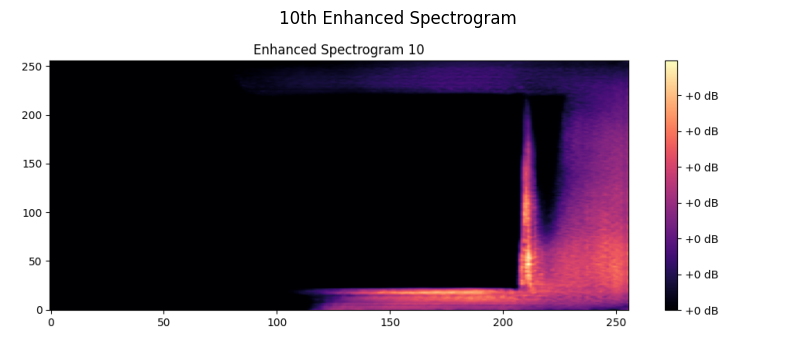

In [ ]:

from PIL import Image




# Function to display the 10th spectrogram image

def view_tenth_spectrogram():

    image_path = 'enhanced_spectrogram_10.png'  # Path to the saved image



    try:

        img = Image.open(image_path)

        plt.figure(figsize=(10, 4))

        plt.imshow(img, aspect='auto')

        plt.axis('off')  # Hide axis for better visualization

        plt.title("10th Enhanced Spectrogram")

        plt.show()

    except FileNotFoundError:

        print(f"Image at {image_path} not found. Make sure it was generated and saved correctly.")




# After generating and saving all spectrograms in the main function, call this function:

if __name__ == "__main__":

    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

    z_dim = 100

    main()

    view_tenth_spectrogram()



##2nd

In [ ]:
import os
from PIL import Image
import torch
import torch.optim as optim
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import torch.nn.utils.spectral_norm as spectral_norm
from torch.optim.lr_scheduler import ExponentialLR
import numpy as np
from torchvision.utils import save_image
import time

class MelSpectrogramDataset(Dataset):
    def __init__(self, image_folder, transform=None):
        self.image_folder = image_folder
        self.transform = transform
        self.image_files = [f for f in os.listdir(image_folder) if f.endswith('.png')]

        # Add error handling for empty directory
        if not self.image_files:
            raise RuntimeError(f"No PNG files found in {image_folder}")

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        try:
            image_path = os.path.join(self.image_folder, self.image_files[idx])
            image = Image.open(image_path).convert('RGB')
            if self.transform:
                image = self.transform(image)
            return image
        except Exception as e:
            print(f"Error loading image {self.image_files[idx]}: {str(e)}")
            # Return a valid tensor with zeros as fallback
            return torch.zeros((3, 64, 64))

class Generator(nn.Module):
    def __init__(self, z_dim, feature_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim

        # Improved architecture with residual connections
        self.initial = nn.Sequential(
            spectral_norm(nn.ConvTranspose2d(z_dim, feature_dim * 8, 4, 1, 0, bias=False)),
            nn.BatchNorm2d(feature_dim * 8),
            nn.ReLU(True)
        )

        self.layer1 = self._make_layer(feature_dim * 8, feature_dim * 4)
        self.layer2 = self._make_layer(feature_dim * 4, feature_dim * 2)
        self.layer3 = self._make_layer(feature_dim * 2, feature_dim)

        self.output = nn.Sequential(
            nn.ConvTranspose2d(feature_dim, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def _make_layer(self, in_channels, out_channels):
        return nn.Sequential(
            spectral_norm(nn.ConvTranspose2d(in_channels, out_channels, 4, 2, 1, bias=False)),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(True),
            nn.Dropout2d(0.2)  # Add dropout for regularization
        )

    def forward(self, x):
        x = self.initial(x)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        return self.output(x)

class Discriminator(nn.Module):
    def __init__(self, feature_dim=64):
        super(Discriminator, self).__init__()

        self.main = nn.Sequential(
            # Initial layer without batch norm
            spectral_norm(nn.Conv2d(3, feature_dim, 4, 2, 1)),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout2d(0.3),

            spectral_norm(nn.Conv2d(feature_dim, feature_dim * 2, 4, 2, 1)),
            nn.BatchNorm2d(feature_dim * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout2d(0.3),

            spectral_norm(nn.Conv2d(feature_dim * 2, feature_dim * 4, 4, 2, 1)),
            nn.BatchNorm2d(feature_dim * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout2d(0.3),

            spectral_norm(nn.Conv2d(feature_dim * 4, feature_dim * 8, 4, 2, 1)),
            nn.BatchNorm2d(feature_dim * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout2d(0.3),

            nn.Conv2d(feature_dim * 8, 1, 4, 1, 0)
        )

    def forward(self, x):
        return self.main(x).view(-1)

class GANTrainer:
    def __init__(self, generator, discriminator, device, z_dim, output_dir='output'):
        self.generator = generator
        self.discriminator = discriminator
        self.device = device
        self.z_dim = z_dim
        self.output_dir = output_dir
        os.makedirs(output_dir, exist_ok=True)

        # Initialize history tracking
        self.g_losses = []
        self.d_losses = []
        self.inception_scores = []

    def save_sample_images(self, epoch):
        self.generator.eval()
        with torch.no_grad():
            sample_z = torch.randn(16, self.z_dim, 1, 1, device=self.device)
            fake_images = self.generator(sample_z)
            save_image(fake_images, f"{self.output_dir}/fake_samples_epoch_{epoch}.png",
                      normalize=True, nrow=4)
        self.generator.train()

    def train(self, dataloader, epochs, lr_g=0.0002, lr_d=0.0002, save_interval=5):
        # Optimizers with different learning rates
        optimizer_g = optim.Adam(self.generator.parameters(), lr=lr_g, betas=(0.5, 0.999))
        optimizer_d = optim.Adam(self.discriminator.parameters(), lr=lr_d, betas=(0.5, 0.999))

        # Learning rate schedulers
        scheduler_g = ExponentialLR(optimizer_g, gamma=0.99)
        scheduler_d = ExponentialLR(optimizer_d, gamma=0.99)

        # Loss function for adversarial loss
        criterion = nn.BCEWithLogitsLoss()

        start_time = time.time()

        for epoch in range(epochs):
            epoch_g_loss = 0
            epoch_d_loss = 0
            batches = 0

            for i, real_images in enumerate(dataloader):
                current_batch_size = real_images.size(0)
                real_images = real_images.to(self.device)

                # Train Discriminator
                self.discriminator.zero_grad()
                label_real = torch.ones(current_batch_size, device=self.device)
                label_fake = torch.zeros(current_batch_size, device=self.device)

                # Add noise to labels for label smoothing
                label_real = label_real * 0.9 + 0.1 * torch.rand_like(label_real)

                # Real images
                output_real = self.discriminator(real_images)
                d_loss_real = criterion(output_real, label_real)

                # Fake images
                z = torch.randn(current_batch_size, self.z_dim, 1, 1, device=self.device)
                fake_images = self.generator(z)
                output_fake = self.discriminator(fake_images.detach())
                d_loss_fake = criterion(output_fake, label_fake)

                d_loss = d_loss_real + d_loss_fake
                d_loss.backward()
                optimizer_d.step()

                # Train Generator
                if i % 2 == 0:  # Train generator less frequently
                    self.generator.zero_grad()
                    output_fake = self.discriminator(fake_images)
                    g_loss = criterion(output_fake, label_real)
                    g_loss.backward()
                    optimizer_g.step()

                    epoch_g_loss += g_loss.item()

                epoch_d_loss += d_loss.item()
                batches += 1

                if i % 100 == 0:
                    elapsed = time.time() - start_time
                    print(f"Epoch [{epoch+1}/{epochs}] Batch [{i}/{len(dataloader)}] "
                          f"D_loss: {d_loss.item():.4f} G_loss: {g_loss.item():.4f} "
                          f"Time: {elapsed:.2f}s")

            # Update learning rates
            scheduler_g.step()
            scheduler_d.step()

            # Save average losses
            self.g_losses.append(epoch_g_loss / batches)
            self.d_losses.append(epoch_d_loss / batches)

            # Generate and save sample images
            if (epoch + 1) % save_interval == 0:
                self.save_sample_images(epoch + 1)

                # Save model checkpoints
                torch.save({
                    'epoch': epoch,
                    'generator_state_dict': self.generator.state_dict(),
                    'discriminator_state_dict': self.discriminator.state_dict(),
                    'g_losses': self.g_losses,
                    'd_losses': self.d_losses,
                }, f"{self.output_dir}/checkpoint_epoch_{epoch+1}.pth")

# Usage and setup
def setup_training(image_folder, batch_size=32, z_dim=100, epochs=50):
    # Set device
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")

    # Data transforms with augmentation
    transform = transforms.Compose([
        transforms.Resize(80),  # Larger size for random crop
        transforms.RandomCrop(64),  # Random crop for data augmentation
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])

    # Initialize dataset and dataloader
    try:
        dataset = MelSpectrogramDataset(image_folder=image_folder, transform=transform)
        dataloader = DataLoader(dataset, batch_size=batch_size,
                              shuffle=True, num_workers=2,
                              pin_memory=True, drop_last=True)
    except Exception as e:
        print(f"Error setting up dataset: {str(e)}")
        return None

    # Initialize models
    generator = Generator(z_dim).to(device)
    discriminator = Discriminator().to(device)

    # Initialize trainer
    trainer = GANTrainer(generator, discriminator, device, z_dim)

    return trainer, dataloader, epochs

# Main execution
if __name__ == "__main__":
    image_folder = '/content/drive/MyDrive/mel_spectrograms'  # Replace with your path
    trainer, dataloader, epochs = setup_training(image_folder)

    if trainer and dataloader:
        try:
            trainer.train(dataloader, epochs)
            print("Training completed successfully!")
        except Exception as e:
            print(f"Error during training: {str(e)}")
    else:
        print("Failed to initialize training.")

Using device: cuda
Epoch [1/50] Batch [0/39] D_loss: 1.3431 G_loss: 0.9178 Time: 9.07s
Epoch [2/50] Batch [0/39] D_loss: 0.2273 G_loss: 4.8781 Time: 24.83s
Epoch [3/50] Batch [0/39] D_loss: 0.2835 G_loss: 6.4780 Time: 40.33s
Epoch [4/50] Batch [0/39] D_loss: 0.2360 G_loss: 6.0349 Time: 56.03s
Epoch [5/50] Batch [0/39] D_loss: 0.2283 G_loss: 5.5950 Time: 71.65s
Epoch [6/50] Batch [0/39] D_loss: 0.2886 G_loss: 4.0749 Time: 87.78s
Epoch [7/50] Batch [0/39] D_loss: 0.3000 G_loss: 6.3997 Time: 103.85s
Epoch [8/50] Batch [0/39] D_loss: 0.3737 G_loss: 3.9711 Time: 119.82s
Epoch [9/50] Batch [0/39] D_loss: 0.2584 G_loss: 5.1509 Time: 135.78s
Epoch [10/50] Batch [0/39] D_loss: 0.2534 G_loss: 6.0478 Time: 151.81s
Epoch [11/50] Batch [0/39] D_loss: 0.2731 G_loss: 5.5642 Time: 167.72s
Epoch [12/50] Batch [0/39] D_loss: 0.2838 G_loss: 3.4016 Time: 183.83s
Epoch [13/50] Batch [0/39] D_loss: 0.2878 G_loss: 4.4507 Time: 200.20s
Epoch [14/50] Batch [0/39] D_loss: 0.2413 G_loss: 5.0766 Time: 216.39s
Epo

KeyboardInterrupt: 

In [ ]:
import os
from PIL import Image
import torch
import torch.optim as optim
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import torch.nn.functional as F
from torch.optim.lr_scheduler import CosineAnnealingLR
import numpy as np
from torchvision.utils import save_image
import time
from torch.cuda.amp import autocast, GradScaler
import wandb  # For experiment tracking

class MelSpectrogramDataset(Dataset):
    def __init__(self, image_folder, transform=None):
        self.image_folder = image_folder
        self.transform = transform
        self.image_files = [f for f in os.listdir(image_folder) if f.endswith(('.png', '.jpg', '.jpeg'))]

        if not self.image_files:
            raise RuntimeError(f"No valid image files found in {image_folder}")

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        try:
            image_path = os.path.join(self.image_folder, self.image_files[idx])
            image = Image.open(image_path).convert('RGB')

            if self.transform:
                image = self.transform(image)

            # Add random noise for robustness
            noise = torch.randn_like(image) * 0.05
            image = image + noise
            image = torch.clamp(image, -1, 1)

            return image
        except Exception as e:
            print(f"Error loading image {self.image_files[idx]}: {str(e)}")
            return torch.zeros((3, 64, 64))

class ResBlock(nn.Module):
    def __init__(self, in_channels, out_channels, downsample=None):
        super(ResBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, 3, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.conv2 = nn.Conv2d(out_channels, out_channels, 3, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.downsample = downsample
        self.relu = nn.LeakyReLU(0.2, inplace=True)

    def forward(self, x):
        identity = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)

        if self.downsample is not None:
            identity = self.downsample(x)

        out += identity
        out = self.relu(out)

        return out

class Generator(nn.Module):
    def __init__(self, z_dim, feature_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim

        self.initial = nn.Sequential(
            nn.ConvTranspose2d(z_dim, feature_dim * 8, 4, 1, 0),
            nn.BatchNorm2d(feature_dim * 8),
            nn.ReLU(True)
        )

        # Residual blocks
        self.res1 = ResBlock(feature_dim * 8, feature_dim * 8)
        self.res2 = ResBlock(feature_dim * 8, feature_dim * 4)
        self.res3 = ResBlock(feature_dim * 4, feature_dim * 2)

        # Upsampling layers
        self.up1 = nn.Sequential(
            nn.ConvTranspose2d(feature_dim * 8, feature_dim * 4, 4, 2, 1),
            nn.BatchNorm2d(feature_dim * 4),
            nn.ReLU(True)
        )

        self.up2 = nn.Sequential(
            nn.ConvTranspose2d(feature_dim * 4, feature_dim * 2, 4, 2, 1),
            nn.BatchNorm2d(feature_dim * 2),
            nn.ReLU(True)
        )

        self.up3 = nn.Sequential(
            nn.ConvTranspose2d(feature_dim * 2, feature_dim, 4, 2, 1),
            nn.BatchNorm2d(feature_dim),
            nn.ReLU(True)
        )

        self.output = nn.Sequential(
            nn.Conv2d(feature_dim, 3, 3, 1, 1),
            nn.Tanh()
        )

        # Self-attention module
        self.attention = SelfAttention(feature_dim * 4)

    def forward(self, x):
        x = self.initial(x)
        x = self.res1(x)
        x = self.up1(x)
        x = self.attention(x)  # Apply attention
        x = self.res2(x)
        x = self.up2(x)
        x = self.res3(x)
        x = self.up3(x)
        return self.output(x)

class SelfAttention(nn.Module):
    def __init__(self, in_channels):
        super(SelfAttention, self).__init__()
        self.query = nn.Conv2d(in_channels, in_channels // 8, 1)
        self.key = nn.Conv2d(in_channels, in_channels // 8, 1)
        self.value = nn.Conv2d(in_channels, in_channels, 1)
        self.gamma = nn.Parameter(torch.zeros(1))

    def forward(self, x):
        batch_size, C, width, height = x.size()

        q = self.query(x).view(batch_size, -1, width * height)
        k = self.key(x).view(batch_size, -1, width * height)
        v = self.value(x).view(batch_size, -1, width * height)

        attention = F.softmax(torch.bmm(q.permute(0, 2, 1), k), dim=2)
        out = torch.bmm(v, attention.permute(0, 2, 1))
        out = out.view(batch_size, C, width, height)

        return self.gamma * out + x

class Discriminator(nn.Module):
    def __init__(self, feature_dim=64):
        super(Discriminator, self).__init__()

        self.main = nn.ModuleList([
            # Initial layer
            nn.Sequential(
                nn.Conv2d(3, feature_dim, 4, 2, 1),
                nn.LeakyReLU(0.2, inplace=True)
            ),

            # Middle layers with residual blocks
            ResBlock(feature_dim, feature_dim * 2),
            ResBlock(feature_dim * 2, feature_dim * 4),
            ResBlock(feature_dim * 4, feature_dim * 8),

            # Self-attention layer
            SelfAttention(feature_dim * 4),

            # Final layers
            nn.Sequential(
                nn.Conv2d(feature_dim * 8, 1, 4, 1, 0),
                nn.Sigmoid()
            )
        ])

    def forward(self, x):
        for layer in self.main:
            x = layer(x)
        return x.view(-1)

class GANTrainer:
    def __init__(self, generator, discriminator, device, z_dim, output_dir='output'):
        self.generator = generator
        self.discriminator = discriminator
        self.device = device
        self.z_dim = z_dim
        self.output_dir = output_dir
        os.makedirs(output_dir, exist_ok=True)

        # Initialize experiment tracking
        wandb.init(project="mel-spectrogram-gan", config={
            "z_dim": z_dim,
            "batch_size": 64,
            "learning_rate": 0.0002
        })

        # Initialize gradient scaler for mixed precision training
        self.scaler = GradScaler()

    def save_sample_images(self, epoch):
        self.generator.eval()
        with torch.no_grad():
            fixed_noise = torch.randn(16, self.z_dim, 1, 1, device=self.device)
            fake_images = self.generator(fixed_noise)
            save_image(fake_images, f"{self.output_dir}/fake_samples_epoch_{epoch}.png",
                      normalize=True, nrow=4)

            # Log to wandb
            wandb.log({
                "generated_images": wandb.Image(fake_images)
            })
        self.generator.train()

    def train(self, dataloader, epochs, lr=0.0002):
        # Optimizers with gradient clipping
        optimizer_g = optim.Adam(self.generator.parameters(), lr=lr, betas=(0.5, 0.999))
        optimizer_d = optim.Adam(self.discriminator.parameters(), lr=lr, betas=(0.5, 0.999))

        # Learning rate schedulers
        scheduler_g = CosineAnnealingLR(optimizer_g, T_max=epochs)
        scheduler_d = CosineAnnealingLR(optimizer_d, T_max=epochs)

        # Loss functions
        adversarial_loss = nn.BCEWithLogitsLoss()

        for epoch in range(epochs):
            for i, real_images in enumerate(dataloader):
                batch_size = real_images.size(0)
                real_images = real_images.to(self.device)

                # Train Discriminator
                optimizer_d.zero_grad()

                with autocast():
                    label_real = torch.ones(batch_size, device=self.device)
                    label_fake = torch.zeros(batch_size, device=self.device)

                    # Add label smoothing
                    label_real = label_real * 0.9 + 0.1 * torch.rand_like(label_real)

                    # Real images
                    output_real = self.discriminator(real_images)
                    d_loss_real = adversarial_loss(output_real, label_real)

                    # Fake images
                    z = torch.randn(batch_size, self.z_dim, 1, 1, device=self.device)
                    fake_images = self.generator(z)
                    output_fake = self.discriminator(fake_images.detach())
                    d_loss_fake = adversarial_loss(output_fake, label_fake)

                    d_loss = (d_loss_real + d_loss_fake) / 2

                self.scaler.scale(d_loss).backward()
                self.scaler.step(optimizer_d)

                # Train Generator
                optimizer_g.zero_grad()

                with autocast():
                    output_fake = self.discriminator(fake_images)
                    g_loss = adversarial_loss(output_fake, label_real)

                self.scaler.scale(g_loss).backward()
                self.scaler.step(optimizer_g)

                self.scaler.update()

                # Log metrics
                if i % 100 == 0:
                    wandb.log({
                        "d_loss": d_loss.item(),
                        "g_loss": g_loss.item(),
                        "epoch": epoch
                    })

                    print(f"Epoch [{epoch+1}/{epochs}] Batch [{i}/{len(dataloader)}] "
                          f"D_loss: {d_loss.item():.4f} G_loss: {g_loss.item():.4f}")

            # Update learning rates
            scheduler_g.step()
            scheduler_d.step()

            # Save sample images and checkpoints
            if (epoch + 1) % 5 == 0:
                self.save_sample_images(epoch)
                torch.save({
                    'epoch': epoch,
                    'generator_state_dict': self.generator.state_dict(),
                    'discriminator_state_dict': self.discriminator.state_dict(),
                }, f"{self.output_dir}/checkpoint_epoch_{epoch+1}.pth")

def setup_training(image_folder, batch_size=64, z_dim=100, epochs=100):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")

    # Advanced data augmentation
    transform = transforms.Compose([
        transforms.Resize(80),
        transforms.RandomCrop(64),
        transforms.RandomHorizontalFlip(),
        transforms.RandomAffine(degrees=5, translate=(0.05, 0.05)),
        transforms.ColorJitter(brightness=0.1, contrast=0.1),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])

    try:
        dataset = MelSpectrogramDataset(image_folder=image_folder, transform=transform)
        dataloader = DataLoader(
            dataset,
            batch_size=batch_size,
            shuffle=True,
            num_workers=4,
            pin_memory=True,
            drop_last=True,
            prefetch_factor=2
        )
    except Exception as e:
        print(f"Error setting up dataset: {str(e)}")
        return None

    generator = Generator(z_dim).to(device)
    discriminator = Discriminator().to(device)

    # Initialize weights
    def init_weights(m):
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
            nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')

    generator.apply(init_weights)
    discriminator.apply(init_weights)

    trainer = GANTrainer(generator, discriminator, device, z_dim)

    return trainer, dataloader, epochs

if __name__ == "__main__":
    image_folder = '/content/drive/MyDrive/mel_spectrograms'
    trainer, dataloader, epochs = setup_training(image_folder)

    if trainer and dataloader:
        try:
            trainer.train(dataloader, epochs)
            print("Training completed successfully!")
        except Exception as e:
            print(f"Error during training: {str(e)}")
    else:
        print("Failed to initialize training.")

Using device: cuda


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.


<IPython.core.display.Javascript object>